# Image similarity experiments

We are trying to assess the feasibility of using CNNs to find groups of similar images, ideally from a huge picture collection. The steps I have in mind are:
* Use a pre-trained CNN such as ResNet-34 or Inception.
* Drop the last layer(s) so the last layer of the "new" model is a dense layer.
* Feed the existing images (downscaled and cropped, if necessary) into the new model to obtain a vector per image.
* Use something like k-NN to find most similar images.

If the last step is too slow, we could explore other alternatives: create clusters first; ask the user to provide the image to try; start with a random image and present images similar to that one; ...

If the idea is feasible, we are planning to build an iOS application to assist users in keeping the unique images they like the most, and delete those that are very similar to them.

In [5]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline

We import all the necessary packages. We are going to work with the [fastai V1 library](http://www.fast.ai/2018/10/02/fastai-ai/) which sits on top of [Pytorch 1.0](https://hackernoon.com/pytorch-1-0-468332ba5163). The fastai library provides many useful functions that enable us to quickly and easily build neural networks and train our models.

In [6]:
from fastai.vision import *
from fastai.metrics import error_rate

If you're using a computer with an unusually small GPU, you may get an out of memory error when running this notebook. If this happens, click Kernel->Restart, uncomment the 2nd line below to use a smaller *batch size* (you'll learn all about what this means during the course), and try again.

In [7]:
bs = 64
# bs = 16   # uncomment this line if you run out of memory even after clicking Kernel->Restart

## Looking at the data

Initially, we are going to use the [Oxford-IIIT Pet Dataset](http://www.robots.ox.ac.uk/~vgg/data/pets/) by [O. M. Parkhi et al., 2012](http://www.robots.ox.ac.uk/~vgg/publications/2012/parkhi12a/parkhi12a.pdf) which features 12 cat breeds and 25 dogs breeds.

Instead of training a classifier on those 37 distinct categories, we'll get vectors from the images in the dataset. We will use "real" images later on.

We are going to use the `untar_data` function to which we must pass a URL as an argument and which will download and extract the data.

In [10]:
path = untar_data(URLs.PETS); path

PosixPath('/Users/pedro/.fastai/data/oxford-iiit-pet')

In [11]:
path.ls()

[PosixPath('/Users/pedro/.fastai/data/oxford-iiit-pet/images'),
 PosixPath('/Users/pedro/.fastai/data/oxford-iiit-pet/annotations')]

In [12]:
path_anno = path/'annotations'
path_img = path/'images'

The first thing we do when we approach a problem is to take a look at the data. We _always_ need to understand very well what the problem is and what the data looks like before we can figure out how to solve it. Taking a look at the data means understanding how the data directories are structured, what the labels are and what some sample images look like.

The main difference between the handling of image classification datasets is the way labels are stored. In this particular dataset, labels are stored in the filenames themselves. We will need to extract them to be able to classify the images into the correct categories. Fortunately, the fastai library has a handy function made exactly for this, `ImageDataBunch.from_name_re` gets the labels from the filenames using a [regular expression](https://docs.python.org/3.6/library/re.html).

In [13]:
fnames = get_image_files(path_img)
fnames[:5]

[PosixPath('/Users/pedro/.fastai/data/oxford-iiit-pet/images/Egyptian_Mau_167.jpg'),
 PosixPath('/Users/pedro/.fastai/data/oxford-iiit-pet/images/pug_52.jpg'),
 PosixPath('/Users/pedro/.fastai/data/oxford-iiit-pet/images/basset_hound_112.jpg'),
 PosixPath('/Users/pedro/.fastai/data/oxford-iiit-pet/images/Siamese_193.jpg'),
 PosixPath('/Users/pedro/.fastai/data/oxford-iiit-pet/images/shiba_inu_122.jpg')]

In [14]:
np.random.seed(2)
pat = r'/([^/]+)_\d+.jpg$'

In [15]:
data = ImageDataBunch.from_name_re(path_img, fnames, pat, ds_tfms=get_transforms(), size=224, bs=bs
                                  ).normalize(imagenet_stats)

In [18]:
data.show_batch(rows=3, figsize=(7,6))

RuntimeError: DataLoader worker (pid 21323) is killed by signal: Unknown signal: 0. 

In [19]:
print(data.classes)
len(data.classes),data.c

['Abyssinian', 'Bengal', 'Birman', 'Bombay', 'British_Shorthair', 'Egyptian_Mau', 'Maine_Coon', 'Persian', 'Ragdoll', 'Russian_Blue', 'Siamese', 'Sphynx', 'american_bulldog', 'american_pit_bull_terrier', 'basset_hound', 'beagle', 'boxer', 'chihuahua', 'english_cocker_spaniel', 'english_setter', 'german_shorthaired', 'great_pyrenees', 'havanese', 'japanese_chin', 'keeshond', 'leonberger', 'miniature_pinscher', 'newfoundland', 'pomeranian', 'pug', 'saint_bernard', 'samoyed', 'scottish_terrier', 'shiba_inu', 'staffordshire_bull_terrier', 'wheaten_terrier', 'yorkshire_terrier']


(37, 37)

## Using resnet34

We will use a pre-trained resnet34 model. Instead of using it as a classifier, we'll create a dense vector that represents each image in the dataset.

I suppose we don't really need to supply the data and create a Learner, we just need the model itself. I need to look into the documentation and see how that would work.

In [160]:
model = models.resnet34(True)
model

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace)
      (conv2): Co

In [162]:
# Last layer
model.fc

Linear(in_features=512, out_features=1000, bias=True)

In [164]:
# Explore output
x = torch.randn(1, 3, 224, 224)
output = model(x)
print(output.shape)
output

torch.Size([1, 512])


tensor([[7.3717e-03, 1.6874e-02, 3.1138e-01, 1.7493e+00, 2.7128e+00, 4.1207e-01,
         1.3249e-01, 4.0280e-01, 1.2458e+00, 1.9802e-01, 2.2184e-01, 7.9195e-01,
         5.1084e-01, 5.2530e-02, 0.0000e+00, 1.3466e+00, 4.6049e+00, 4.7637e-01,
         0.0000e+00, 1.5307e+00, 4.9840e+00, 9.0179e-02, 2.4560e-01, 1.0825e-01,
         5.6332e-02, 9.8172e-02, 1.0653e+00, 4.4978e-01, 1.4651e+00, 1.1388e+00,
         1.5135e+00, 0.0000e+00, 5.8718e-02, 1.2118e-03, 6.6704e-01, 5.4976e-02,
         1.2845e-01, 2.9704e-03, 5.2461e-02, 0.0000e+00, 9.5708e-01, 4.1959e-02,
         1.4291e-01, 7.0898e-02, 0.0000e+00, 0.0000e+00, 1.0547e+00, 9.8791e-01,
         1.2336e+00, 0.0000e+00, 6.3921e-01, 2.7706e-01, 2.6880e-02, 2.5035e-01,
         1.9940e-01, 3.9284e-01, 1.6539e-01, 3.7348e-01, 2.3108e-01, 1.0484e-01,
         4.7748e-02, 1.2014e+00, 1.3131e-02, 2.5704e+00, 2.8539e-01, 1.3612e+00,
         2.7493e-02, 2.9008e-01, 1.6136e-02, 7.4741e-01, 2.0229e+00, 1.0597e-01,
         2.1146e+00, 6.3094e

In [165]:
# "Disable" last layer and explore output
class Identity(nn.Module):
    def __init__(self):
        super(Identity, self).__init__()
        
    def forward(self, x):
        return x
    
model.fc = Identity()

# Put the model in evaluation mode
model.eval()

output = model(x)
print(output.shape)
output

torch.Size([1, 512])


tensor([[7.3717e-03, 1.6874e-02, 3.1138e-01, 1.7493e+00, 2.7128e+00, 4.1207e-01,
         1.3249e-01, 4.0280e-01, 1.2458e+00, 1.9802e-01, 2.2184e-01, 7.9195e-01,
         5.1084e-01, 5.2530e-02, 0.0000e+00, 1.3466e+00, 4.6049e+00, 4.7637e-01,
         0.0000e+00, 1.5307e+00, 4.9840e+00, 9.0179e-02, 2.4560e-01, 1.0825e-01,
         5.6332e-02, 9.8172e-02, 1.0653e+00, 4.4978e-01, 1.4651e+00, 1.1388e+00,
         1.5135e+00, 0.0000e+00, 5.8718e-02, 1.2118e-03, 6.6704e-01, 5.4976e-02,
         1.2845e-01, 2.9704e-03, 5.2461e-02, 0.0000e+00, 9.5708e-01, 4.1959e-02,
         1.4291e-01, 7.0898e-02, 0.0000e+00, 0.0000e+00, 1.0547e+00, 9.8791e-01,
         1.2336e+00, 0.0000e+00, 6.3921e-01, 2.7706e-01, 2.6880e-02, 2.5035e-01,
         1.9940e-01, 3.9284e-01, 1.6539e-01, 3.7348e-01, 2.3108e-01, 1.0484e-01,
         4.7748e-02, 1.2014e+00, 1.3131e-02, 2.5704e+00, 2.8539e-01, 1.3612e+00,
         2.7493e-02, 2.9008e-01, 1.6136e-02, 7.4741e-01, 2.0229e+00, 1.0597e-01,
         2.1146e+00, 6.3094e

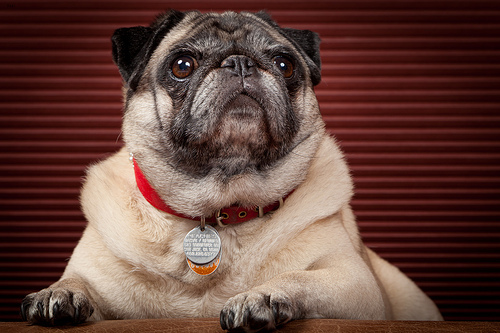

In [166]:
data.x[1]

In [167]:
import torchvision

In [168]:
type(data.x[1])

fastai.vision.image.Image

In [169]:
data.x[1].shape

torch.Size([3, 333, 500])

In [170]:
torch.Size([3, 256, (256*500//333)])

torch.Size([3, 256, 384])

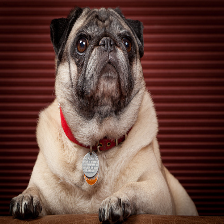

In [202]:
#resized_sample = data.x[1].resize(torch.Size([3, 224, (224*500//333)]))
#resized_sample = data.x[1].resize(torch.Size([3, 224*333//500, 224]))
resized_sample = data.x[1].resize(224)
resized_sample

In [203]:
# We need another dimension
resized_sample.data.unsqueeze(0).shape

torch.Size([1, 3, 224, 224])

In [204]:
# Apply the model
v1 = model(resized_sample.data.unsqueeze(0))
v1

tensor([[3.4802e-01, 2.4713e+00, 1.9167e-01, 1.6888e+00, 1.0895e+00, 3.1145e-01,
         1.4122e+00, 8.9442e-01, 5.4833e-03, 1.7168e+00, 2.1226e+00, 4.3669e-01,
         3.5218e+00, 2.8415e-01, 2.7318e-01, 6.3176e-01, 3.6719e-01, 8.2288e-01,
         1.9382e+00, 1.1080e+00, 1.9527e+00, 3.7660e-01, 5.4194e-01, 1.6249e-01,
         3.5847e-01, 1.1124e-02, 1.3720e-02, 2.2177e-01, 1.6946e-01, 4.6872e-01,
         1.2555e+00, 6.7806e-01, 7.4871e-01, 4.5922e-01, 1.4374e+00, 2.1913e-01,
         6.1491e-02, 0.0000e+00, 1.2233e-01, 7.7177e+00, 1.0385e+00, 3.1070e-01,
         9.1229e-01, 7.6090e-02, 2.8557e-01, 3.7599e-01, 9.7787e-01, 5.9606e-01,
         5.2064e-01, 2.4513e+00, 4.8002e-03, 1.8390e+00, 5.1918e-01, 1.4005e-01,
         3.4583e-01, 6.3777e-02, 1.2015e+00, 8.8912e-01, 5.5380e-01, 2.8431e+00,
         2.0790e+00, 7.5186e-03, 2.4051e+00, 1.8425e-01, 2.1196e-01, 3.2654e+00,
         6.6479e-02, 6.6315e-01, 1.6278e-01, 1.8452e-01, 1.0810e-01, 8.8581e-01,
         8.5390e-01, 9.8701e

In [205]:
v1.shape

torch.Size([1, 512])

## Apply model to many images

We will use the data bunch to select a number of images to apply the model to.

In [104]:
help(ImageDataBunch)

Help on class ImageDataBunch in module fastai.vision.data:

class ImageDataBunch(fastai.basic_data.DataBunch)
 |  ImageDataBunch(train_dl: torch.utils.data.dataloader.DataLoader, valid_dl: torch.utils.data.dataloader.DataLoader, fix_dl: torch.utils.data.dataloader.DataLoader = None, test_dl: Union[torch.utils.data.dataloader.DataLoader, NoneType] = None, device: torch.device = None, dl_tfms: Union[Collection[Callable], NoneType] = None, path: Union[pathlib.Path, str] = '.', collate_fn: Callable = <function data_collate at 0x1339c8158>, no_check: bool = False)
 |  
 |  DataBunch suitable for computer vision.
 |  
 |  Method resolution order:
 |      ImageDataBunch
 |      fastai.basic_data.DataBunch
 |      builtins.object
 |  
 |  Methods defined here:
 |  
 |  batch_stats(self, funcs: Collection[Callable] = None) -> torch.Tensor
 |      Grab a batch of data and call reduction function `func` per channel
 |  
 |  normalize(self, stats: Collection[torch.Tensor] = None, do_x: bool = True

In [110]:
data.train_ds.x

ImageItemList (5912 items)
[Image (3, 275, 183), Image (3, 333, 500), Image (3, 500, 374), Image (3, 332, 500), Image (3, 375, 500)]...
Path: /Users/pedro/.fastai/data/oxford-iiit-pet/images

In [123]:
data.dl(data.x[0])

DeviceDataLoader(dl=<torch.utils.data.dataloader.DataLoader object at 0x13a772dd8>, device=device(type='cpu'), tfms=[functools.partial(<function _normalize_batch at 0x133f28f28>, mean=tensor([0.4850, 0.4560, 0.4060]), std=tensor([0.2290, 0.2240, 0.2250]), do_x=True, do_y=False)], collate_fn=<function data_collate at 0x1339c8158>)

In [126]:
data.x[:100]

ImageItemList (100 items)
[Image (3, 275, 183), Image (3, 333, 500), Image (3, 500, 374), Image (3, 332, 500), Image (3, 375, 500)]...
Path: /Users/pedro/.fastai/data/oxford-iiit-pet/images

In [273]:
max_images = 1000

def resize_224(x):
    return x.resize(224)

def pred_image(x, model):
    # Resize by stretching to 224x224.
    # Skipping normalization for now.
    resized_x = resize_224(x)
    print(resized_x)
    return model(resized_x.data.unsqueeze(0))

# I'm sure this can be done in a much better way,
# but I don't know the APIs yet
def pred_images(image_list, model, max_images):
    vectors = []
    for x in image_list[:max_images]:
        vectors.append(pred_image(x, model))
        
    return vectors
        
vectors = pred_images(data.x, model, max_images)
vectors

Image (3, 275, 183)
Image (3, 333, 500)
Image (3, 500, 374)
Image (3, 332, 500)
Image (3, 375, 500)
Image (3, 398, 500)
Image (3, 500, 392)
Image (3, 375, 500)
Image (3, 500, 333)
Image (3, 333, 500)
Image (3, 300, 225)
Image (3, 300, 225)
Image (3, 432, 428)
Image (3, 210, 280)
Image (3, 333, 500)
Image (3, 500, 334)
Image (3, 426, 500)
Image (3, 375, 500)
Image (3, 375, 500)
Image (3, 375, 500)
Image (3, 375, 500)
Image (3, 225, 300)
Image (3, 467, 467)
Image (3, 500, 378)
Image (3, 375, 500)
Image (3, 375, 500)
Image (3, 300, 222)
Image (3, 375, 500)
Image (3, 375, 500)
Image (3, 603, 500)
Image (3, 331, 500)
Image (3, 333, 500)
Image (3, 225, 300)
Image (3, 349, 500)
Image (3, 333, 500)
Image (3, 375, 500)
Image (3, 375, 500)
Image (3, 375, 500)
Image (3, 334, 500)
Image (3, 300, 285)
Image (3, 500, 335)
Image (3, 350, 233)
Image (3, 400, 500)
Image (3, 368, 500)
Image (3, 400, 600)
Image (3, 400, 500)
Image (3, 343, 500)
Image (3, 500, 500)
Image (3, 331, 500)
Image (3, 500, 333)


Image (3, 500, 333)
Image (3, 408, 500)
Image (3, 333, 500)
Image (3, 374, 500)
Image (3, 236, 260)
Image (3, 282, 288)
Image (3, 333, 500)
Image (3, 334, 500)
Image (3, 200, 300)
Image (3, 375, 500)
Image (3, 408, 500)
Image (3, 335, 500)
Image (3, 510, 625)
Image (3, 2160, 1440)
Image (3, 333, 500)
Image (3, 333, 500)
Image (3, 333, 500)
Image (3, 317, 500)
Image (3, 225, 300)
Image (3, 334, 500)
Image (3, 500, 333)
Image (3, 500, 333)
Image (3, 500, 333)
Image (3, 209, 300)
Image (3, 500, 375)
Image (3, 375, 500)
Image (3, 339, 500)
Image (3, 333, 500)
Image (3, 333, 500)
Image (3, 375, 500)
Image (3, 375, 500)
Image (3, 500, 357)
Image (3, 225, 300)
Image (3, 375, 500)
Image (3, 500, 375)
Image (3, 375, 500)
Image (3, 500, 416)
Image (3, 462, 500)
Image (3, 377, 500)
Image (3, 375, 500)
Image (3, 375, 500)
Image (3, 375, 500)
Image (3, 333, 500)
Image (3, 500, 375)
Image (3, 404, 500)
Image (3, 333, 500)
Image (3, 333, 500)
Image (3, 388, 500)
Image (3, 375, 500)
Image (3, 500, 375

Image (3, 500, 375)
Image (3, 375, 500)
Image (3, 375, 500)
Image (3, 225, 300)
Image (3, 332, 500)
Image (3, 375, 500)
Image (3, 375, 500)
Image (3, 333, 500)
Image (3, 332, 500)
Image (3, 375, 500)
Image (3, 300, 223)
Image (3, 455, 500)
Image (3, 363, 500)
Image (3, 378, 500)
Image (3, 435, 500)
Image (3, 333, 500)
Image (3, 333, 500)
Image (3, 333, 500)
Image (3, 375, 500)
Image (3, 300, 300)
Image (3, 500, 414)
Image (3, 225, 300)
Image (3, 500, 489)
Image (3, 333, 500)
Image (3, 375, 500)
Image (3, 375, 500)
Image (3, 500, 461)
Image (3, 375, 500)
Image (3, 270, 229)
Image (3, 333, 500)
Image (3, 333, 500)
Image (3, 202, 157)
Image (3, 309, 500)
Image (3, 333, 500)
Image (3, 500, 333)
Image (3, 500, 500)
Image (3, 333, 500)
Image (3, 334, 500)
Image (3, 499, 432)
Image (3, 500, 333)
Image (3, 340, 500)
Image (3, 375, 500)
Image (3, 500, 415)
Image (3, 500, 344)
Image (3, 500, 334)
Image (3, 320, 500)
Image (3, 225, 300)
Image (3, 375, 500)
Image (3, 500, 333)
Image (3, 375, 500)


[tensor([[8.7187e-01, 7.7071e-01, 1.3759e+00, 9.4941e-01, 1.2448e-01, 3.1144e-01,
          5.4321e-01, 2.8046e-01, 1.1405e+00, 1.3204e+00, 6.8459e-01, 6.4387e-01,
          1.6811e+00, 9.9944e-01, 1.2832e-01, 1.0411e+00, 5.9032e-01, 1.9751e+00,
          1.8775e-01, 4.5601e-01, 1.4484e+00, 2.6528e+00, 1.6015e+00, 6.5533e-01,
          1.3098e+00, 1.7646e-01, 5.4367e-02, 1.7334e+00, 9.4838e-01, 1.3185e-01,
          2.5625e-01, 4.0958e-01, 5.6802e-02, 2.7922e-01, 2.7038e-01, 1.3607e+00,
          5.5418e-01, 1.3213e-02, 2.2998e-01, 1.0331e+00, 1.9607e-01, 1.3984e+00,
          0.0000e+00, 9.9031e-01, 3.8722e-01, 1.6759e-01, 5.6154e-01, 3.7312e+00,
          6.1941e-01, 3.4036e+00, 4.1971e-02, 1.3726e+00, 8.6427e-02, 7.6315e-01,
          2.0310e+00, 1.0510e+00, 1.5859e+00, 1.2456e+00, 8.7960e-01, 3.2432e+00,
          2.4026e+00, 2.1480e-01, 1.0192e+00, 7.7973e-02, 7.4245e-02, 1.9766e+00,
          3.2344e+00, 2.1141e+00, 2.9013e-01, 6.4453e-01, 6.9425e-01, 2.3435e+00,
          5.1328

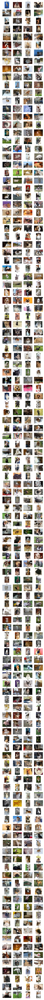

In [298]:
fig = plt.figure(figsize=(10, 500))
columns = 4
rows = (max_images + 4) // columns

num_images = 500   # max_images
for i in range(0, num_images):
    ax = fig.add_subplot(rows, columns, i+1)
    #plt.imshow(data.x[i].data)
    data.x[i].show(ax=ax, title=i)

plt.show()

In [340]:
# Eval another image and select the most similar one from the set above
test_sample = 4600
#test_sample = 4444
v = pred_image(data.x[test_sample], model)

Image (3, 333, 480)


In [341]:
# Compute minimum difference
def min_from_set(v_test, vectors):
    min_diff = float("inf")
    min_i = 0

    # ToDo: use actual length here
    for i in range(0, max_images):
        cur_diff = sum(abs(v_test[0] - vectors[i][0])).item()
        if cur_diff < min_diff:
            min_diff = cur_diff
            min_i = i
        
    return (min_i, min_diff)

(min_i, min_diff) = min_from_set(v, vectors)
print("Minimum different at", min_i, ": ", min_diff)

Minimum different at 225 :  285.2760314941406


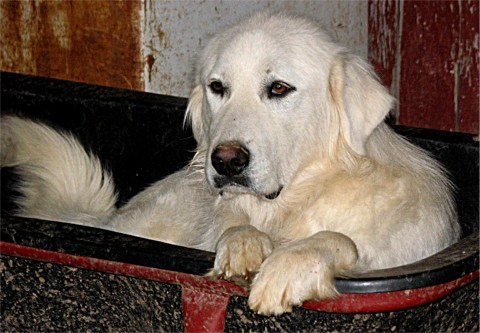

In [342]:
data.x[test_sample]

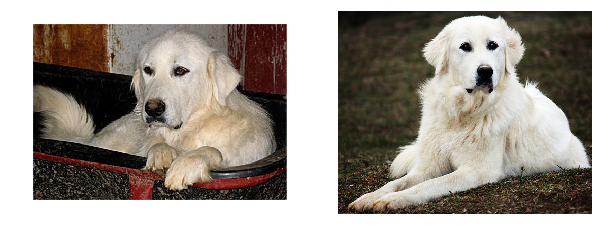

In [343]:
fig = plt.figure(figsize=(10, 10))

ax = fig.add_subplot(1, 2, 1)
data.x[test_sample].show(ax)

ax = fig.add_subplot(1, 2, 2)
data.x[min_i].show(ax)

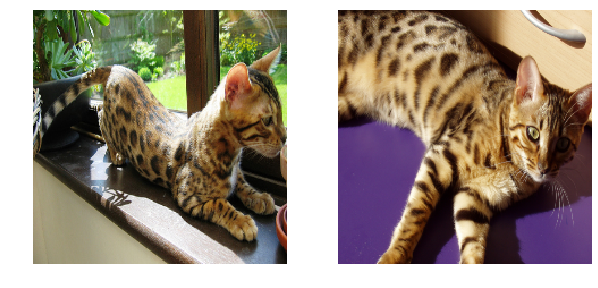

In [335]:
fig = plt.figure(figsize=(10, 10))

ax = fig.add_subplot(1, 2, 1)
data.x[test_sample].resize(224).show(ax)
ax = fig.add_subplot(1, 2, 2)
data.x[min_i].resize(224).show(ax)

### Find the most similar image to one of the images in 2000:2500

In [337]:
absolute_min = float("inf")
i_test = 0
i_similar = 0

for i in range(2000, 2500):
    v = pred_image(data.x[i], model)
    (min_i, min_diff) = min_from_set(v, vectors)
    if min_diff < absolute_min:
        absolute_min = min_diff
        i_test = i
        i_similar = min_i
    print(i, "min:", absolute_min, "(", i_test, ",", i_similar, ")")

Image (3, 333, 500)
2000 min: 266.2478332519531 ( 2000 , 225 )
Image (3, 330, 500)
2001 min: 266.2478332519531 ( 2000 , 225 )
Image (3, 351, 500)
2002 min: 266.2478332519531 ( 2000 , 225 )
Image (3, 375, 500)
2003 min: 243.5410614013672 ( 2003 , 182 )
Image (3, 313, 500)
2004 min: 243.5410614013672 ( 2003 , 182 )
Image (3, 375, 500)
2005 min: 243.5410614013672 ( 2003 , 182 )
Image (3, 375, 500)
2006 min: 243.5410614013672 ( 2003 , 182 )
Image (3, 333, 500)
2007 min: 243.5410614013672 ( 2003 , 182 )
Image (3, 433, 500)
2008 min: 243.5410614013672 ( 2003 , 182 )
Image (3, 481, 500)
2009 min: 172.40975952148438 ( 2009 , 254 )
Image (3, 334, 500)
2010 min: 172.40975952148438 ( 2009 , 254 )
Image (3, 333, 500)
2011 min: 172.40975952148438 ( 2009 , 254 )
Image (3, 333, 500)
2012 min: 172.40975952148438 ( 2009 , 254 )
Image (3, 500, 375)
2013 min: 172.40975952148438 ( 2009 , 254 )
Image (3, 225, 300)
2014 min: 172.40975952148438 ( 2009 , 254 )
Image (3, 375, 500)
2015 min: 172.40975952148438 

2128 min: 171.65797424316406 ( 2034 , 196 )
Image (3, 375, 500)
2129 min: 171.65797424316406 ( 2034 , 196 )
Image (3, 300, 300)
2130 min: 171.65797424316406 ( 2034 , 196 )
Image (3, 500, 372)
2131 min: 171.65797424316406 ( 2034 , 196 )
Image (3, 500, 363)
2132 min: 171.65797424316406 ( 2034 , 196 )
Image (3, 375, 500)
2133 min: 171.65797424316406 ( 2034 , 196 )
Image (3, 309, 500)
2134 min: 171.65797424316406 ( 2034 , 196 )
Image (3, 333, 500)
2135 min: 171.65797424316406 ( 2034 , 196 )
Image (3, 333, 500)
2136 min: 171.65797424316406 ( 2034 , 196 )
Image (3, 333, 500)
2137 min: 171.65797424316406 ( 2034 , 196 )
Image (3, 335, 500)
2138 min: 171.65797424316406 ( 2034 , 196 )
Image (3, 335, 500)
2139 min: 171.65797424316406 ( 2034 , 196 )
Image (3, 500, 375)
2140 min: 171.65797424316406 ( 2034 , 196 )
Image (3, 500, 333)
2141 min: 171.65797424316406 ( 2034 , 196 )
Image (3, 500, 375)
2142 min: 171.65797424316406 ( 2034 , 196 )
Image (3, 375, 500)
2143 min: 171.65797424316406 ( 2034 , 19

2257 min: 104.79622650146484 ( 2187 , 784 )
Image (3, 333, 500)
2258 min: 104.79622650146484 ( 2187 , 784 )
Image (3, 333, 500)
2259 min: 104.79622650146484 ( 2187 , 784 )
Image (3, 375, 500)
2260 min: 104.79622650146484 ( 2187 , 784 )
Image (3, 333, 500)
2261 min: 104.79622650146484 ( 2187 , 784 )
Image (3, 375, 500)
2262 min: 104.79622650146484 ( 2187 , 784 )
Image (3, 334, 500)
2263 min: 104.79622650146484 ( 2187 , 784 )
Image (3, 375, 500)
2264 min: 104.79622650146484 ( 2187 , 784 )
Image (3, 500, 333)
2265 min: 104.79622650146484 ( 2187 , 784 )
Image (3, 333, 500)
2266 min: 104.79622650146484 ( 2187 , 784 )
Image (3, 500, 375)
2267 min: 104.79622650146484 ( 2187 , 784 )
Image (3, 500, 327)
2268 min: 104.79622650146484 ( 2187 , 784 )
Image (3, 366, 500)
2269 min: 104.79622650146484 ( 2187 , 784 )
Image (3, 454, 500)
2270 min: 104.79622650146484 ( 2187 , 784 )
Image (3, 500, 333)
2271 min: 104.79622650146484 ( 2187 , 784 )
Image (3, 375, 500)
2272 min: 104.79622650146484 ( 2187 , 78

2386 min: 104.79622650146484 ( 2187 , 784 )
Image (3, 500, 415)
2387 min: 104.79622650146484 ( 2187 , 784 )
Image (3, 444, 500)
2388 min: 104.79622650146484 ( 2187 , 784 )
Image (3, 225, 300)
2389 min: 104.79622650146484 ( 2187 , 784 )
Image (3, 375, 500)
2390 min: 104.79622650146484 ( 2187 , 784 )
Image (3, 375, 500)
2391 min: 104.79622650146484 ( 2187 , 784 )
Image (3, 500, 333)
2392 min: 104.79622650146484 ( 2187 , 784 )
Image (3, 447, 500)
2393 min: 104.79622650146484 ( 2187 , 784 )
Image (3, 500, 334)
2394 min: 104.79622650146484 ( 2187 , 784 )
Image (3, 500, 333)
2395 min: 104.79622650146484 ( 2187 , 784 )
Image (3, 300, 400)
2396 min: 104.79622650146484 ( 2187 , 784 )
Image (3, 194, 259)
2397 min: 104.79622650146484 ( 2187 , 784 )
Image (3, 375, 500)
2398 min: 104.79622650146484 ( 2187 , 784 )
Image (3, 500, 330)
2399 min: 104.79622650146484 ( 2187 , 784 )
Image (3, 500, 355)
2400 min: 104.79622650146484 ( 2187 , 784 )
Image (3, 205, 300)
2401 min: 104.79622650146484 ( 2187 , 78

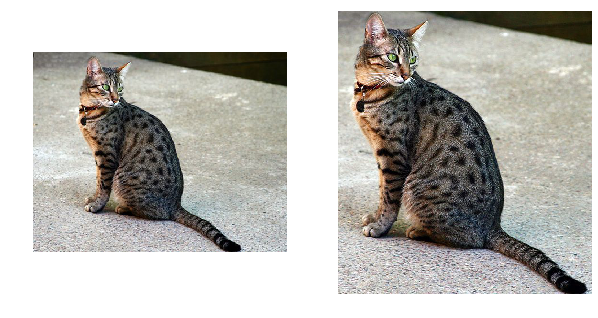

In [339]:
fig = plt.figure(figsize=(10, 10))

ax = fig.add_subplot(1, 2, 1)
data.x[2187].show(ax)
ax = fig.add_subplot(1, 2, 2)
data.x[784].show(ax)